---
# **PyCaret for Clustering**
---
- It is a bundle of many Machine Learning algorithms.
- Only three lines of code is required to compare 20 ML models.
- Pycaret is available for:
    - Classification
    - Regression
    - Clustering

---

### **Self learning resource**
1. Tutorial on Pycaret **<a href="https://pycaret.readthedocs.io/en/latest/tutorials.html"> Click Here</a>**

2. Documentation on Pycaret-Clustering: **<a href="https://pycaret.readthedocs.io/en/latest/api/clustering.html"> Click Here </a>**

---


### **(a) Install Pycaret**

In [3]:
!pip install pycaret &> /dev/null
print ("Pycaret installed sucessfully!!")

Pycaret installed sucessfully!!


### **(b) Get the version of the pycaret**

In [4]:
from pycaret.utils import version
version()

'3.3.2'

---
# **1. Clustering - Part 1 (Kmean Clustering)**
---
### **1.1 Get the list of datasets available in pycaret (55)**

In [5]:
from pycaret.datasets import get_data
dataSets = get_data('index')

,Dataset,Data Types,Default Task,Target Variable 1,Target Variable 2,# Instances,# Attributes,Missing Values
0,anomaly,Multivariate,Anomaly Detection,NaN,NaN,1000,10,N
1,france,Multivariate,Association Rule Mining,InvoiceNo,Description,8557,8,N
2,germany,Multivariate,Association Rule Mining,InvoiceNo,Description,9495,8,N
3,bank,Multivariate,Classification (Binary),deposit,NaN,45211,17,N
4,blood,Multivariate,Classification (Binary),Class,NaN,748,5,N
5,cancer,Multivariate,Classification (Binary),Class,NaN,683,10,N
6,credit,Multivariate,Classification (Binary),default,NaN,24000,24,N
7,diabetes,Multivariate,Classification (Binary),Class variable,NaN,768,9,N
8,electrical_grid,Multivariate,Classification (Binary),stabf,NaN,10000,14,N
9,employee,Multivariate,Classification (Binary),left,NaN,14999,10,N


---
### **1.2 Get the "jewellery" dataset**
---

In [6]:
pokemonDataSet = get_data("pokemon")    # SN is 30
# This is unsupervised dataset.
# No target is defined.

,#,Name,Type 1,Type 2,Total,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary
0,1,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,1,False
1,2,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,1,False
2,3,Venusaur,Grass,Poison,525,80,82,83,100,100,80,1,False
3,3,VenusaurMega Venusaur,Grass,Poison,625,80,100,123,122,120,80,1,False
4,4,Charmander,Fire,NaN,309,39,52,43,60,50,65,1,False


---
### **1.3 Download the "jewellery" dataset to local system**
---

In [7]:
pokemonDataSet.to_csv("pokemonDataSet.csv")
from google.colab import files
files.download('pokemonDataSet.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

  ---
### **1.4 "Parameter setting"  for clustering model**
##### **Train/Test division, applying data pre-processing** {Sampling, Normalization, Transformation, PCA, Handaling of Outliers, Feature Selection}
---

In [8]:
from pycaret.clustering import *
kMeanClusteringParameters = setup(pokemonDataSet)
# Re-run the code if any error occur

,Description,Value
0,Session id,3129
1,Original data shape,"(800, 13)"
2,Transformed data shape,"(800, 846)"
3,Numeric features,9
4,Categorical features,3
5,Rows with missing values,48.2%
6,Preprocess,True
7,Imputation type,simple
8,Numeric imputation,mean
9,Categorical imputation,mode


---
### **1.5 Building "KMean" clustering model**
---

In [11]:
KMeanClusteringModel = create_model('kmeans', num_clusters=4
                                    )

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3454,640.2016,1.1152,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

---
### **1.6 Assign Model - "Assign the labels" to the dataset**
---



In [12]:
kMeanPrediction = assign_model(KMeanClusteringModel)
kMeanPrediction

,#,Name,Type 1,Type 2,Total,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary,Cluster
0,1,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,1,False,Cluster 2
1,2,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,1,False,Cluster 2
2,3,Venusaur,Grass,Poison,525,80,82,83,100,100,80,1,False,Cluster 0
3,3,VenusaurMega Venusaur,Grass,Poison,625,80,100,123,122,120,80,1,False,Cluster 0
4,4,Charmander,Fire,NaN,309,39,52,43,60,50,65,1,False,Cluster 2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
795,719,Diancie,Rock,Fairy,600,50,100,150,100,150,50,6,True,Cluster 1
796,719,DiancieMega Diancie,Rock,Fairy,700,50,160,110,160,110,110,6,True,Cluster 1
797,720,HoopaHoopa Confined,Psychic,Ghost,600,80,110,60,150,130,70,6,True,Cluster 1
798,720,HoopaHoopa Unbound,Psychic,Dark,680,80,160,60,170,130,80,6,True,Cluster 1


---
### **1.7 Clustering in "Three line of code"**
---

In [13]:
from pycaret.clustering import *

kMeanClusteringParameters = setup(pokemonDataSet, verbose=False)
KMeanClusteringModel = create_model('kmeans', num_clusters=4)
kMeanPrediction = assign_model(KMeanClusteringModel)
kMeanPrediction

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3069,615.2643,1.1671,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

,#,Name,Type 1,Type 2,Total,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary,Cluster
0,1,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,1,False,Cluster 1
1,2,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,1,False,Cluster 1
2,3,Venusaur,Grass,Poison,525,80,82,83,100,100,80,1,False,Cluster 2
3,3,VenusaurMega Venusaur,Grass,Poison,625,80,100,123,122,120,80,1,False,Cluster 2
4,4,Charmander,Fire,NaN,309,39,52,43,60,50,65,1,False,Cluster 1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
795,719,Diancie,Rock,Fairy,600,50,100,150,100,150,50,6,True,Cluster 0
796,719,DiancieMega Diancie,Rock,Fairy,700,50,160,110,160,110,110,6,True,Cluster 0
797,720,HoopaHoopa Confined,Psychic,Ghost,600,80,110,60,150,130,70,6,True,Cluster 0
798,720,HoopaHoopa Unbound,Psychic,Dark,680,80,160,60,170,130,80,6,True,Cluster 0


---
### **1.8 "Saving" the result**
---



In [14]:
kMeanPrediction.to_csv("KMeanResult.csv")
print("Result file save sucessfully!!")

Result file save sucessfully!!


---
### **1.9 Download the "result file" to user local system**
---

In [16]:
from google.colab import files
files.download('KMeanResult.csv')      # Uncomment this line
 #Open and Explore result file (KMeanResult.csv).

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

---
# **2. Clustering: Saving and Loading the Model**
---
### **2.1 Save the "trained model"**
---

In [17]:
x = save_model(KMeanClusteringModel, 'kMeanClusteringModelFile')

Transformation Pipeline and Model Successfully Saved


---
### **2.2 Download the "trained model**
---

In [18]:
from google.colab import files
files.download('kMeanClusteringModelFile.pkl')      # Uncomment this line

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

---
### **2.3 Load the model**
---
##### Use it, while working on **"Anaconda/Jupyter notebook"** on local machine

In [19]:
KMeanClusteringModel1 = load_model('kMeanClusteringModelFile')

Transformation Pipeline and Model Successfully Loaded


---
### **2.4 Upload and Load the trained model to "Colab Environment"**
---
##### **Upload the trained model**

In [20]:
from google.colab import files
files.upload()                     # Uncomment this line

Saving kMeanClusteringModelFile.pkl to kMeanClusteringModelFile (1).pkl


{'kMeanClusteringModelFile (1).pkl': b'\x80\x04\x95"\x02\x00\x00\x00\x00\x00\x00\x8c\x19pycaret.internal.pipeline\x94\x8c\x08Pipeline\x94\x93\x94)\x81\x94}\x94(\x8c\x05steps\x94]\x94(\x8c\x11numerical_imputer\x94\x8c(pycaret.internal.preprocess.transformers\x94\x8c\x12TransformerWrapper\x94\x93\x94)\x81\x94}\x94(\x8c\x0btransformer\x94\x8c\x14sklearn.impute._base\x94\x8c\rSimpleImputer\x94\x93\x94)\x81\x94}\x94(\x8c\x0emissing_values\x94G\x7f\xf8\x00\x00\x00\x00\x00\x00\x8c\radd_indicator\x94\x89\x8c\x13keep_empty_features\x94\x89\x8c\x08strategy\x94\x8c\x04mean\x94\x8c\nfill_value\x94N\x8c\x04copy\x94\x88\x8c\x11feature_names_in_\x94\x8c\x13joblib.numpy_pickle\x94\x8c\x11NumpyArrayWrapper\x94\x93\x94)\x81\x94}\x94(\x8c\x08subclass\x94\x8c\x05numpy\x94\x8c\x07ndarray\x94\x93\x94\x8c\x05shape\x94K\t\x85\x94\x8c\x05order\x94\x8c\x01C\x94\x8c\x05dtype\x94h!\x8c\x05dtype\x94\x93\x94\x8c\x02O8\x94\x89\x88\x87\x94R\x94(K\x03\x8c\x01|\x94NNNJ\xff\xff\xff\xffJ\xff\xff\xff\xffK?t\x94b\x8c\nallo

##### **Load the trained model**

In [21]:
KMeanClusteringModel1 = load_model('kMeanClusteringModelFile (1)')

Transformation Pipeline and Model Successfully Loaded


---
# **3. Clustering: Cluster the new dataset (Unseen Data)**
---
### **3.1 Select some data or upload user dataset file**

In [22]:
# Select top 10 rows
newData = get_data("pokemon").iloc[:10]

,#,Name,Type 1,Type 2,Total,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary
0,1,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,1,False
1,2,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,1,False
2,3,Venusaur,Grass,Poison,525,80,82,83,100,100,80,1,False
3,3,VenusaurMega Venusaur,Grass,Poison,625,80,100,123,122,120,80,1,False
4,4,Charmander,Fire,NaN,309,39,52,43,60,50,65,1,False


---
### **3.2 Make prediction on the new dataset (Unseen Data)**
---

In [23]:
newPredictions = predict_model(KMeanClusteringModel, data = newData)
newPredictions

,#,Name_Bulbasaur,Name_Ivysaur,Name_Venusaur,Name_VenusaurMega Venusaur,Name_Charmander,Name_Charmeleon,Name_Charizard,Name_CharizardMega Charizard X,Name_CharizardMega Charizard Y,...,Total,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary,Cluster
0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,318.0,45.0,49.0,49.0,65.0,65.0,45.0,1.0,False,Cluster 1
1,2.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,405.0,60.0,62.0,63.0,80.0,80.0,60.0,1.0,False,Cluster 1
2,3.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,525.0,80.0,82.0,83.0,100.0,100.0,80.0,1.0,False,Cluster 2
3,3.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,625.0,80.0,100.0,123.0,122.0,120.0,80.0,1.0,False,Cluster 2
4,4.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,...,309.0,39.0,52.0,43.0,60.0,50.0,65.0,1.0,False,Cluster 1
5,5.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,405.0,58.0,64.0,58.0,80.0,65.0,80.0,1.0,False,Cluster 1
6,6.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,534.0,78.0,84.0,78.0,109.0,85.0,100.0,1.0,False,Cluster 2
7,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,...,634.0,78.0,130.0,111.0,130.0,85.0,100.0,1.0,False,Cluster 2
8,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,634.0,78.0,104.0,78.0,159.0,115.0,100.0,1.0,False,Cluster 2
9,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,314.0,44.0,48.0,65.0,50.0,64.0,43.0,1.0,False,Cluster 1


---
### **3.3 Save the prediction result to csv**
---

In [24]:
newPredictions.to_csv("NewPredictions.csv")
print("Result file save sucessfully!!")

Result file save sucessfully!!


---
# **4. Clustering: Ploting the Cluster**
---
```
- Cluster PCA Plot (2d)          'cluster'
- Cluster TSnE (3d)              'tsne'
- Elbow Plot                     'elbow'
- Silhouette Plot                'silhouette'
- Distance Plot                  'distance'
- Distribution Plot              'distribution'
```

---
### **4.1 Evaluate Cluster Model**
---

In [25]:
evaluate_model(KMeanClusteringModel)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

---
### **4.2 2D-plot for Cluster**
---

In [ ]:
plot_model(KMeanClusteringModel, plot='cluster')

---
### **4.3 3D-plot for Cluster**
---

In [ ]:
plot_model(KMeanClusteringModel, plot = 'tsne')

---
### **4.4 Elbow Plot**
---

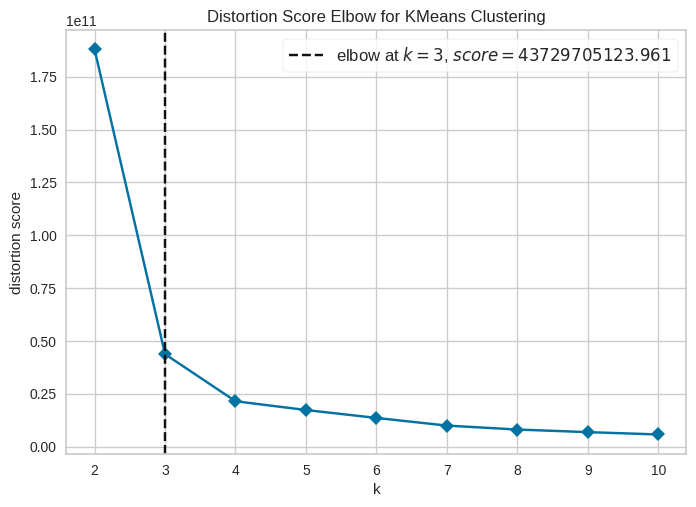

In [ ]:
plot_model(KMeanClusteringModel, plot = 'elbow')

---
### **4.5 Silhouette Plot**
---

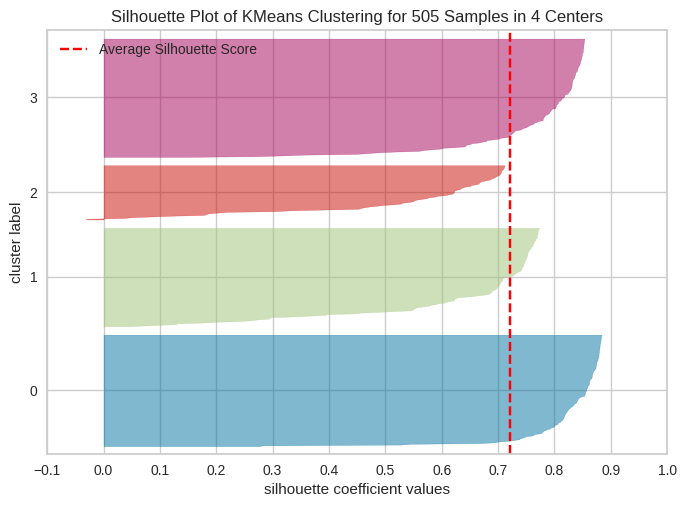

In [ ]:
plot_model(KMeanClusteringModel, plot = 'silhouette')

---
### **4.6 Distribution Plot**
---

In [ ]:
plot_model(KMeanClusteringModel, plot = 'distribution')

---
### **4.7 Distance Plot**
---

In [ ]:
# plot_model(KMeanClusteringModel, plot = 'distance') # Rerun the code

---
# **5. Compelete Code for Clustering (KMean)**
---
### **5.1 For Cluster = 3, 4, 5, 6**

In [26]:
from pycaret.datasets import get_data
from pycaret.clustering import *

pokemonDataSet = get_data('pokemon', verbose=False)
setup(data = pokemonDataSet, verbose=False)

print("For Cluster = 3")
x = create_model('kmeans', num_clusters = 3)

print("For Cluster = 4")
x = create_model('kmeans', num_clusters = 4)

print("For Cluster = 5")
x = create_model('kmeans', num_clusters = 5)

print("For Cluster = 6")
x = create_model('kmeans', num_clusters = 6)

For Cluster = 3


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3454,640.2016,1.1152,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 4


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3160,612.2016,1.0904,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 5


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3201,628.7812,1.0016,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 6


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3270,651.4176,0.9497,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

---
### **5.2 Other Clustering Algorithms**
---
```
- K-Means clustering                 'kmeans'
- Affinity Propagation               'ap'
- Mean shift clustering              'meanshift'
- Spectral Clustering                'sc'
- Agglomerative Clustering           'hclust'
- Density-Based Spatial Clustering   'dbscan'
- OPTICS Clustering                  'optics'
- Birch Clustering                   'birch'
- K-Modes clustering                 'kmodes'
```

---
# **6. Clustering: Apply "Data Preprocessing"**
---
### **Read the Dataset**

In [27]:
from pycaret.clustering import *
from pycaret.datasets import get_data

pokemonDataSet = get_data('pokemon')

,#,Name,Type 1,Type 2,Total,HP,Attack,Defense,Sp. Atk,Sp. Def,Speed,Generation,Legendary
0,1,Bulbasaur,Grass,Poison,318,45,49,49,65,65,45,1,False
1,2,Ivysaur,Grass,Poison,405,60,62,63,80,80,60,1,False
2,3,Venusaur,Grass,Poison,525,80,82,83,100,100,80,1,False
3,3,VenusaurMega Venusaur,Grass,Poison,625,80,100,123,122,120,80,1,False
4,4,Charmander,Fire,NaN,309,39,52,43,60,50,65,1,False


---
### **6.1 Model Performance using "Normalization"**
---
### **6.1.1 Elbow Plot**


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0043,2.3720,9.9424,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

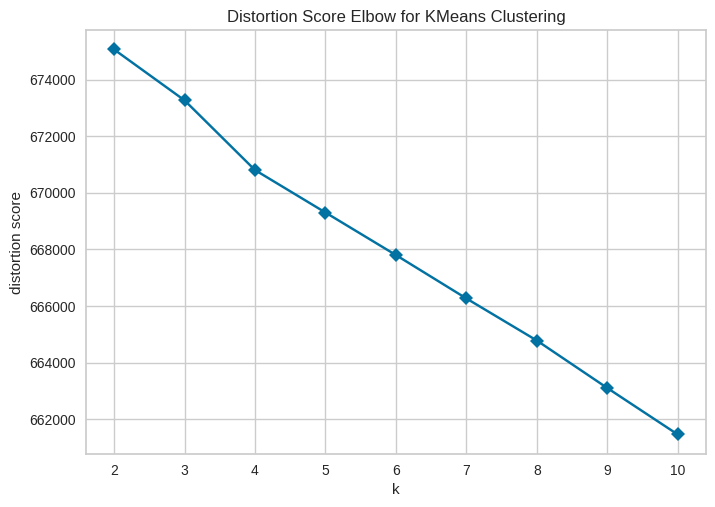

In [28]:
setup(data = pokemonDataSet, normalize = True, normalize_method = 'zscore', verbose=False)
x = create_model('kmeans')
plot_model(x, plot = 'elbow')

---
### **6.1.2 Evaluation parameters for Cluster = 3, 4, 5, 6**
---

In [29]:
setup(data = pokemonDataSet, normalize = True, normalize_method = 'zscore', verbose=False)

print("For Cluster = 3")
x = create_model('kmeans', num_clusters = 3)

print("For Cluster = 4")
x = create_model('kmeans', num_clusters = 4)

print("For Cluster = 5")
x = create_model('kmeans', num_clusters = 5)

print("For Cluster = 6")
x = create_model('kmeans', num_clusters = 6)


For Cluster = 3


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0041,2.6592,12.1339,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 4


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0005,2.3236,13.5645,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 5


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,-0.0002,2.1227,12.8766,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 6


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0001,1.9907,11.8484,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

---
### **6.1.3 3D Plot for Cluster = 5**
---

In [30]:
setup(data = pokemonDataSet, normalize = True, normalize_method = 'zscore', verbose=False)
x = create_model('kmeans', num_clusters = 5)
plot_model(x, plot = 'tsne')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0014,1.9930,11.2766,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

---
### **6.2 Model Performance using "Transformation"**
---

### **6.2.1 Elbow Plot**


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.7809,3519.5778,0.3135,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

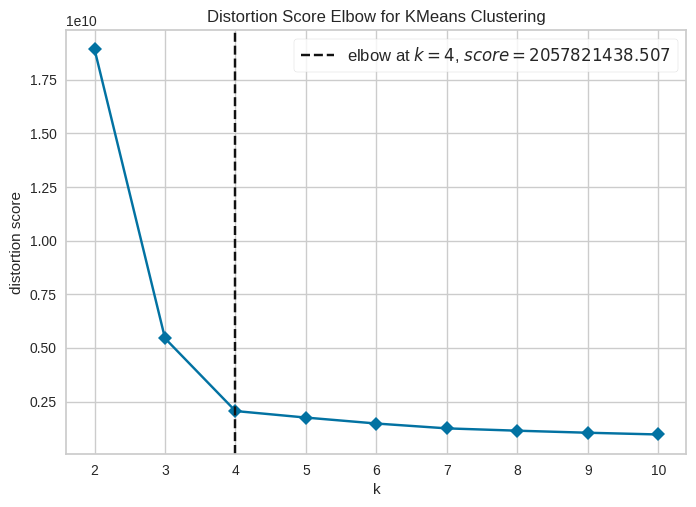

In [ ]:
setup(data = jewelleryDataSet, transformation = True, transformation_method = 'yeo-johnson', verbose=False)
x = create_model('kmeans')
plot_model(x, plot = 'elbow')

---
### **6.2.2 Evaluation parameters for Cluster = 3, 4, 5, 6**
---

In [31]:
setup(data = pokemonDataSet, transformation = True, transformation_method = 'yeo-johnson', verbose=False)

print("For Cluster = 3")
x = create_model('kmeans', num_clusters = 3)

print("For Cluster = 4")
x = create_model('kmeans', num_clusters = 4)

print("For Cluster = 5")
x = create_model('kmeans', num_clusters = 5)

print("For Cluster = 6")
x = create_model('kmeans', num_clusters = 6)

For Cluster = 3


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.4008,1167.6152,0.8744,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 4


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3493,1024.7136,1.0047,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 5


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3569,974.2538,0.9181,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 6


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3503,964.7693,0.9325,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

---
### **6.3 Model Performance using "PCA"**
---
### **6.3.1 Elbow Plot**

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3144,612.1224,1.1028,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

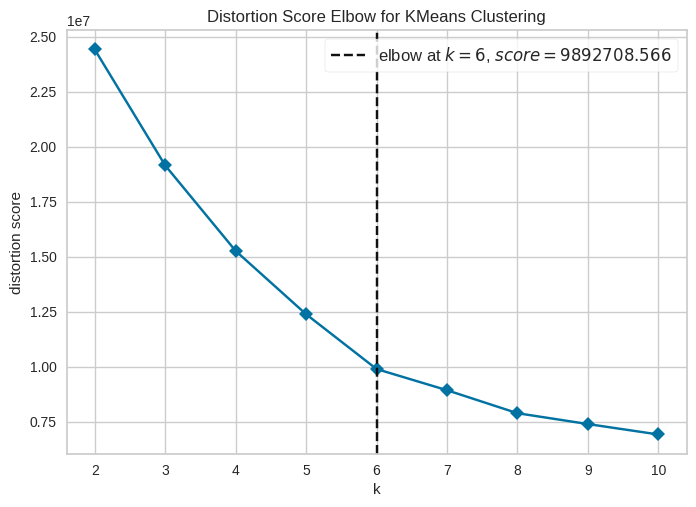

In [32]:
setup(data = pokemonDataSet, pca = True, pca_method = 'linear', verbose=False)
x = create_model('kmeans')
plot_model(x, plot = 'elbow')

---
### **6.3.2 Evaluation parameters for Cluster = 3, 4, 5, 6**
---

In [33]:
setup(data = pokemonDataSet, pca = True, pca_method = 'linear', verbose=False)

print("For Cluster = 3")
x = create_model('kmeans', num_clusters = 3)

print("For Cluster = 4")
x = create_model('kmeans', num_clusters = 4)

print("For Cluster = 5")
x = create_model('kmeans', num_clusters = 5)

print("For Cluster = 6")
x = create_model('kmeans', num_clusters = 6)

For Cluster = 3


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3295,652.4557,1.0779,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 4


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3345,644.6835,0.9707,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 5


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3063,607.2879,1.0102,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 6


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3269,651.3867,0.9497,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

---
### **6.4 Model Performance using "Transformation" + "Normalization"**
---
### **6.4.1 Elbow Plot**

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0002,1.7520,13.1911,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

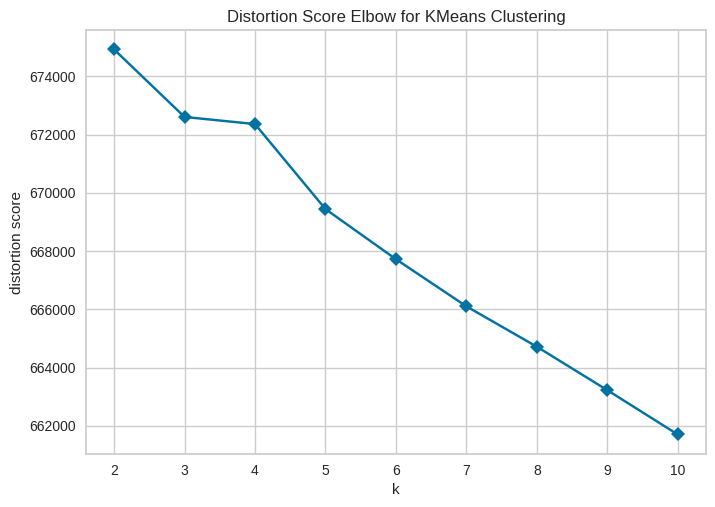

In [34]:
setup(data = pokemonDataSet, transformation = True, normalize = True,
      normalize_method = 'zscore', transformation_method = 'yeo-johnson', verbose=False)
x = create_model('kmeans')
plot_model(x, plot = 'elbow')

---
### **6.4.2 Evaluation parameters for Cluster = 3, 4, 5, 6**
---

In [ ]:
setup(data = pokemonDataSet, transformation = True, normalize = True,
      normalize_method = 'zscore', transformation_method = 'yeo-johnson', verbose=False)

print("For Cluster = 3")
x = create_model('kmeans', num_clusters = 3)

print("For Cluster = 4")
x = create_model('kmeans', num_clusters = 4)

print("For Cluster = 5")
x = create_model('kmeans', num_clusters = 5)

print("For Cluster = 6")
x = create_model('kmeans', num_clusters = 6)

For Cluster = 3


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.6912,1016.4677,0.5410,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 4


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.7544,1467.4682,0.3868,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 5


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.8063,3503.4024,0.2748,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 6


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.6329,3054.7759,0.7229,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

---
### **6.5 Model Performance using "Transformation" + "Normalization" + "PCA"**
---
### **6.5.1 Elbow Plot**

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.7544,1467.4682,0.3868,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

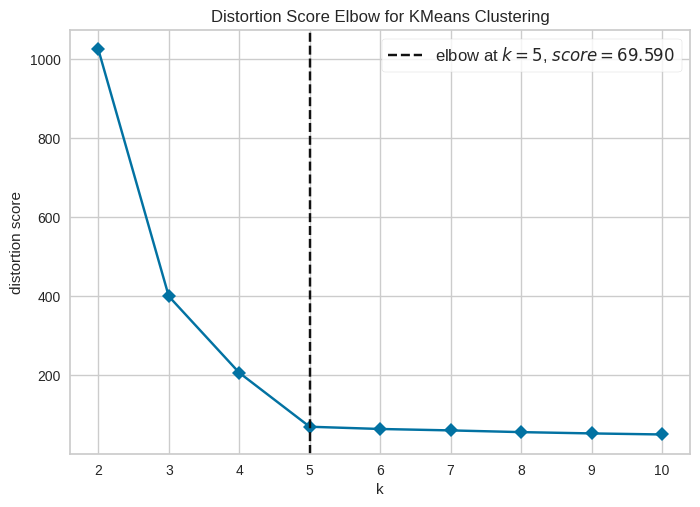

In [ ]:
setup(data = pokemonDataSet, transformation = True, normalize = True, pca = True,
      normalize_method = 'zscore', transformation_method = 'yeo-johnson',
      pca_method = 'linear', verbose=False)
x = create_model('kmeans')
plot_model(x, plot = 'elbow')

---
### **6.5.2 Evaluation parameters for Cluster = 3, 4, 5, 6**
---

In [35]:
setup(data = pokemonDataSet, transformation = True, normalize = True, pca = True,
      normalize_method = 'zscore',
      transformation_method = 'yeo-johnson',
      pca_method = 'linear', verbose=False)

print("For Cluster = 3")
x = create_model('kmeans', num_clusters = 3)

print("For Cluster = 4")
x = create_model('kmeans', num_clusters = 4)

print("For Cluster = 5")
x = create_model('kmeans', num_clusters = 5)

print("For Cluster = 6")
x = create_model('kmeans', num_clusters = 6)

For Cluster = 3


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0013,2.2963,15.6184,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 4


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0017,2.1443,13.1099,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 5


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0021,2.1127,11.6740,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

For Cluster = 6


,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.0005,2.0999,10.6340,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

---
# **7. Other Clustering Techniques**
---
```
K-Means clustering                 'kmeans'
Affinity Propagation               'ap'
Mean shift clustering              'meanshift'
Spectral Clustering                'sc'
Agglomerative Clustering           'hclust'
Density-Based Spatial Clustering   'dbscan'
OPTICS Clustering                  'optics'
Birch Clustering                   'birch'
K-Modes clustering                 'kmodes'
```

---
### **7.1 Buildign Agglomerative (Hierarchical) clustering model**
---

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.3051,593.0329,1.0624,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

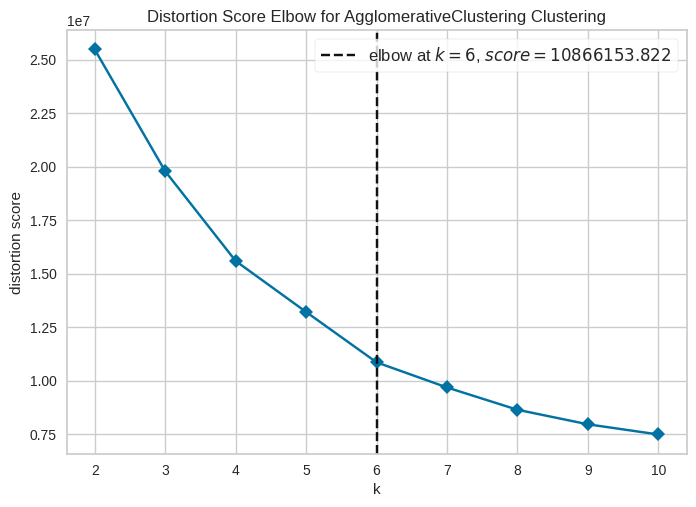

In [36]:
from pycaret.datasets import get_data
from pycaret.clustering import *

jewelleryDataSet = get_data('pokemon', verbose=False)
setup(data = pokemonDataSet, verbose=False)

x = create_model('hclust')
plot_model(x, plot = 'elbow')

---
### **7.1.1 Assign Model - "Assign the labels" to the dataset**
---



In [ ]:
hierarchicalModel = create_model('hclust', num_clusters=3)
hierarchicalModelPrediction = assign_model(hierarchicalModel)
hierarchicalModelPrediction

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.7391,3542.6251,0.3407,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

,Age,Income,SpendingScore,Savings,Cluster
0,58,77769,0.791329,6559.830078,Cluster 2
1,59,81799,0.791082,5417.661621,Cluster 2
2,62,74751,0.702657,9258.993164,Cluster 2
3,59,74373,0.765680,7346.334473,Cluster 2
4,87,17760,0.348778,16869.507812,Cluster 1
...,...,...,...,...,...
500,28,101206,0.387441,14936.775391,Cluster 0
501,93,19934,0.203140,17969.693359,Cluster 1
502,90,35297,0.355149,16091.402344,Cluster 1
503,91,20681,0.354679,18401.087891,Cluster 1


---
### **7.1.2 Evaluate Agglomerative (Hierarchical) Clustering**
---

In [ ]:
evaluate_model(hierarchicalModel)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

---
### **7.2 Density-Based Spatial Clustering**
---

In [37]:
from pycaret.datasets import get_data
from pycaret.clustering import *

jewelleryDataSet = get_data('pokemon', verbose=False)
setup(data = jewelleryDataSet, verbose=False)
dbscanModel = create_model('dbscan')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0,0,0,0,0,0


Processing:   0%|          | 0/3 [00:00<?, ?it/s]

---
### **7.2.1 Assign Model - "Assign the labels" to the dataset**
---



In [ ]:
dbscanModelPrediction = assign_model(dbscanModel)
dbscanModelPrediction

# Noisy samples are given the label -1 i.e. 'Cluster -1'

,Age,Income,SpendingScore,Savings,Cluster
0,58,77769,0.791329,6559.830078,Cluster -1
1,59,81799,0.791082,5417.661621,Cluster -1
2,62,74751,0.702657,9258.993164,Cluster -1
3,59,74373,0.765680,7346.334473,Cluster -1
4,87,17760,0.348778,16869.507812,Cluster -1
...,...,...,...,...,...
500,28,101206,0.387441,14936.775391,Cluster -1
501,93,19934,0.203140,17969.693359,Cluster -1
502,90,35297,0.355149,16091.402344,Cluster -1
503,91,20681,0.354679,18401.087891,Cluster -1
